<a href="https://colab.research.google.com/github/VinayWankhede11/Book-Recommendation-System/blob/main/Book_Recommendation_System.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<b><h1>Books Recommendation System

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import re
import pickle
import operator
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter
from scipy.sparse import csr_matrix
from pandas.api.types import is_numeric_dtype
from sklearn.neighbors import NearestNeighbors
from sklearn.feature_extraction import DictVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import TfidfVectorizer

import warnings
warnings.filterwarnings("ignore")

<b><h3>Dataset

In [ ]:
books = pd.read_csv(r"/content/drive/MyDrive/INTERNSHIP/Books.csv", delimiter=';', error_bad_lines=False, encoding='ISO-8859-1', warn_bad_lines=False)
users = pd.read_csv(r"/content/drive/MyDrive/INTERNSHIP/Users.csv", delimiter=';', error_bad_lines=False, encoding='ISO-8859-1', warn_bad_lines=False)
ratings = pd.read_csv(r"/content/drive/MyDrive/INTERNSHIP/Book-Ratings.csv", delimiter=';', error_bad_lines=False, encoding='ISO-8859-1', warn_bad_lines=False)

print("Books Data:    ", books.shape)
print("Users Data:    ", users.shape)
print("Books-ratings: ", ratings.shape)

Books Data:     (271360, 8)
Users Data:     (278858, 3)
Books-ratings:  (1149780, 3)


<b> <h2> EDA Exploratory Data Analysis

- <b><h3>Pre-Processing Books Dataset



In [ ]:
print("Columns in Books: ", list(books.columns))
books.head()

Columns in Books:  ['ISBN', 'Book-Title', 'Book-Author', 'Year-Of-Publication', 'Publisher', 'Image-URL-S', 'Image-URL-M', 'Image-URL-L']


,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0195153448.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0195153448.01.LZZZZZZZ.jpg
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0002005018.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0002005018.01.LZZZZZZZ.jpg
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0060973129.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0060973129.01.LZZZZZZZ.jpg
3,0374157065,Flu: The Story of the Great Influenza Pandemic of 1918 and the Search for the Virus That Caused It,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0374157065.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0374157065.01.LZZZZZZZ.jpg
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0393045218.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0393045218.01.LZZZZZZZ.jpg


In [ ]:
## Checking for null values
books.isnull().sum() 

ISBN                   0
Book-Title             0
Book-Author            1
Year-Of-Publication    0
Publisher              2
Image-URL-S            0
Image-URL-M            0
Image-URL-L            3
dtype: int64

In [ ]:
books.loc[books['Book-Author'].isnull(),:]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
187689,9627982032,The Credit Suisse Guide to Managing Your Personal Wealth,NaN,1995,Edinburgh Financial Publishing,http://images.amazon.com/images/P/9627982032.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/9627982032.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/9627982032.01.LZZZZZZZ.jpg


In [ ]:
books.loc[books['Publisher'].isnull(),:]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
128890,193169656X,Tyrant Moon,Elaine Corvidae,2002,NaN,http://images.amazon.com/images/P/193169656X.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/193169656X.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/193169656X.01.LZZZZZZZ.jpg
129037,1931696993,Finders Keepers,Linnea Sinclair,2001,NaN,http://images.amazon.com/images/P/1931696993.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/1931696993.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/1931696993.01.LZZZZZZZ.jpg


In [ ]:
books.at[187689 ,'Book-Author'] = 'Others'
books.at[128890 ,'Publisher'] = 'Others'
books.at[129037 ,'Publisher'] = 'Others'

In [ ]:
## Checking for column Year-of-publication
books['Year-Of-Publication'].unique()

array([2002, 2001, 1991, 1999, 2000, 1993, 1996, 1988, 2004, 1998, 1994,
       2003, 1997, 1983, 1979, 1995, 1982, 1985, 1992, 1986, 1978, 1980,
       1952, 1987, 1990, 1981, 1989, 1984, 0, 1968, 1961, 1958, 1974,
       1976, 1971, 1977, 1975, 1965, 1941, 1970, 1962, 1973, 1972, 1960,
       1966, 1920, 1956, 1959, 1953, 1951, 1942, 1963, 1964, 1969, 1954,
       1950, 1967, 2005, 1957, 1940, 1937, 1955, 1946, 1936, 1930, 2011,
       1925, 1948, 1943, 1947, 1945, 1923, 2020, 1939, 1926, 1938, 2030,
       1911, 1904, 1949, 1932, 1928, 1929, 1927, 1931, 1914, 2050, 1934,
       1910, 1933, 1902, 1924, 1921, 1900, 2038, 2026, 1944, 1917, 1901,
       2010, 1908, 1906, 1935, 1806, 2021, '2000', '1995', '1999', '2004',
       '2003', '1990', '1994', '1986', '1989', '2002', '1981', '1993',
       '1983', '1982', '1976', '1991', '1977', '1998', '1992', '1996',
       '0', '1997', '2001', '1974', '1968', '1987', '1984', '1988',
       '1963', '1956', '1970', '1985', '1978', '1973', '1980'

In [ ]:
pd.set_option('display.max_colwidth', -1)

In [ ]:
books.loc[books['Year-Of-Publication'] == 'DK Publishing Inc',:]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
209538,078946697X,"DK Readers: Creating the X-Men, How It All Began (Level 4: Proficient Readers)\"";Michael Teitelbaum""",2000,DK Publishing Inc,http://images.amazon.com/images/P/078946697X.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/078946697X.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/078946697X.01.LZZZZZZZ.jpg,NaN
221678,0789466953,"DK Readers: Creating the X-Men, How Comic Books Come to Life (Level 4: Proficient Readers)\"";James Buckley""",2000,DK Publishing Inc,http://images.amazon.com/images/P/0789466953.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0789466953.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0789466953.01.LZZZZZZZ.jpg,NaN


In [ ]:
books.loc[books['Year-Of-Publication'] == 'Gallimard',:]

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
220731,2070426769,"Peuple du ciel, suivi de 'Les Bergers\"";Jean-Marie Gustave Le ClÃ?Â©zio""",2003,Gallimard,http://images.amazon.com/images/P/2070426769.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/2070426769.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/2070426769.01.LZZZZZZZ.jpg,NaN


In [ ]:
books.at[209538 ,'Publisher'] = 'DK Publishing Inc'
books.at[209538 ,'Year-Of-Publication'] = 2000
books.at[209538 ,'Book-Title'] = 'DK Readers: Creating the X-Men, How It All Began (Level 4: Proficient Readers)'
books.at[209538 ,'Book-Author'] = 'Michael Teitelbaum'
books.at[209538 ,'Image-URL-L'] = 'http://images.amazon.com/images/P/078946697X.01.LZZZZZZZ.jpg'

books.at[221678 ,'Publisher'] = 'DK Publishing Inc'
books.at[221678 ,'Year-Of-Publication'] = 2000
books.at[221678 ,'Book-Title'] = 'DK Readers: Creating the X-Men, How Comic Books Come to Life (Level 4: Proficient Readers)'
books.at[221678 ,'Book-Author'] = 'James Buckley'
books.at[221678 ,'Image-URL-L'] = 'http://images.amazon.com/images/P/0789466953.01.LZZZZZZZ.jpg'

books.at[220731 ,'Publisher'] = 'Gallimard'
books.at[220731 ,'Year-Of-Publication'] = '2003'
books.at[220731 ,'Book-Title'] = 'Peuple du ciel - Suivi de Les bergers '
books.at[220731 ,'Book-Author'] = 'Jean-Marie Gustave Le ClÃ?Â©zio'
books.at[220731 ,'Image-URL-L'] = 'http://images.amazon.com/images/P/2070426769.01.LZZZZZZZ.jpg'

In [ ]:
## Converting year of publication in Numbers
books['Year-Of-Publication'] = books['Year-Of-Publication'].astype(int)

In [ ]:
print(sorted(list(books['Year-Of-Publication'].unique())))

[0, 1376, 1378, 1806, 1897, 1900, 1901, 1902, 1904, 1906, 1908, 1909, 1910, 1911, 1914, 1917, 1919, 1920, 1921, 1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929, 1930, 1931, 1932, 1933, 1934, 1935, 1936, 1937, 1938, 1939, 1940, 1941, 1942, 1943, 1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959, 1960, 1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2008, 2010, 2011, 2012, 2020, 2021, 2024, 2026, 2030, 2037, 2038, 2050]


In [ ]:
## Replacing Invalid years with max year
count = Counter(books['Year-Of-Publication'])
[k for k, v in count.items() if v == max(count.values())]

[2002]

In [ ]:
# replacing invalid years with current year like(0,2050)
books.loc[books['Year-Of-Publication'] > 2023, 'Year-Of-Publication'] = 2023
books.loc[books['Year-Of-Publication'] == 0, 'Year-Of-Publication'] = 2023

In [ ]:
## Uppercasing all alphabets in ISBN
books['ISBN'] = books['ISBN'].str.upper()

In [ ]:
## Drop duplicate rows
books.drop_duplicates(keep='last', inplace=True) 
books.reset_index(drop = True, inplace = True)

In [ ]:
books.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 271047 entries, 0 to 271046
Data columns (total 8 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   ISBN                 271047 non-null  object
 1   Book-Title           271047 non-null  object
 2   Book-Author          271047 non-null  object
 3   Year-Of-Publication  271047 non-null  int64 
 4   Publisher            271047 non-null  object
 5   Image-URL-S          271047 non-null  object
 6   Image-URL-M          271047 non-null  object
 7   Image-URL-L          271047 non-null  object
dtypes: int64(1), object(7)
memory usage: 16.5+ MB


In [ ]:
books.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0195153448,Classical Mythology,Mark P. O. Morford,2002,Oxford University Press,http://images.amazon.com/images/P/0195153448.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0195153448.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0195153448.01.LZZZZZZZ.jpg
1,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0002005018.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0002005018.01.LZZZZZZZ.jpg
2,0060973129,Decision in Normandy,Carlo D'Este,1991,HarperPerennial,http://images.amazon.com/images/P/0060973129.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0060973129.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0060973129.01.LZZZZZZZ.jpg
3,0374157065,Flu: The Story of the Great Influenza Pandemic of 1918 and the Search for the Virus That Caused It,Gina Bari Kolata,1999,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0374157065.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0374157065.01.LZZZZZZZ.jpg
4,0393045218,The Mummies of Urumchi,E. J. W. Barber,1999,W. W. Norton &amp; Company,http://images.amazon.com/images/P/0393045218.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0393045218.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0393045218.01.LZZZZZZZ.jpg


- <b><h3>Pre-Processing Users Dataset

In [ ]:
print("Columns in Users: ", list(users.columns))
users.head()

Columns in Users:  ['User-ID', 'Location', 'Age']


,User-ID,Location,Age
0,1,"nyc, new york, usa",NaN
1,2,"stockton, california, usa",18.0
2,3,"moscow, yukon territory, russia",NaN
3,4,"porto, v.n.gaia, portugal",17.0
4,5,"farnborough, hants, united kingdom",NaN


In [ ]:
users.shape

(278858, 3)

In [ ]:
## Checking null values
print(users.isna().sum())               

User-ID     0     
Location    0     
Age         110762
dtype: int64


In [ ]:
## Check for all values present in Age column
print(sorted(list(users['Age'].unique())))

[nan, 0.0, 1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0, 41.0, 42.0, 43.0, 44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 52.0, 53.0, 54.0, 55.0, 56.0, 57.0, 58.0, 59.0, 60.0, 61.0, 62.0, 63.0, 64.0, 65.0, 66.0, 67.0, 68.0, 69.0, 70.0, 71.0, 72.0, 73.0, 74.0, 75.0, 76.0, 77.0, 78.0, 79.0, 80.0, 81.0, 82.0, 83.0, 84.0, 85.0, 86.0, 87.0, 88.0, 89.0, 90.0, 91.0, 92.0, 93.0, 94.0, 95.0, 96.0, 97.0, 98.0, 99.0, 100.0, 101.0, 102.0, 103.0, 104.0, 105.0, 106.0, 107.0, 108.0, 109.0, 110.0, 111.0, 113.0, 114.0, 115.0, 116.0, 118.0, 119.0, 123.0, 124.0, 127.0, 128.0, 132.0, 133.0, 136.0, 137.0, 138.0, 140.0, 141.0, 143.0, 146.0, 147.0, 148.0, 151.0, 152.0, 156.0, 157.0, 159.0, 162.0, 168.0, 172.0, 175.0, 183.0, 186.0, 189.0, 199.0, 200.0, 201.0, 204.0, 207.0, 208.0, 209.0, 210.0, 212.0, 219.0, 220.0, 223.0, 226.0

In [ ]:
# restricting max and min values of age 
valid_age = users[users['Age'] <= 90]
valid_age = valid_age[valid_age['Age'] >= 7]

In [ ]:
mean = round(valid_age['Age'].mean())   
mean

35

In [ ]:
users.loc[users['Age'] > 90, 'Age'] = mean    #age greater than 90 are substituted with mean 
users.loc[users['Age'] < 7, 'Age'] = mean    #age less than 7 years are substitued with mean
users['Age'] = users['Age'].fillna(mean)      #filling null values with mean

In [ ]:
users['Age'] = users['Age'].astype(int)       #changing Datatype to int

In [ ]:
new_list = users.Location.str.split(', ')
new_list

0         [nyc, new york, usa]                                                                                       
1         [stockton, california, usa]                                                                                
2         [moscow, yukon territory, russia]                                                                          
3         [porto, v.n.gaia, portugal]                                                                                
4         [farnborough, hants, united kingdom]                                                                       
5         [santa monica, california, usa]                                                                            
6         [washington, dc, usa]                                                                                      
7         [timmins, ontario, canada]                                                                                 
8         [germantown, tennessee, usa]                  

In [ ]:
new_list = users.Location.str.split(', ')

city = []
state = []
country = []
count_no_state = 0    
count_no_country = 0

for i in range(0,len(new_list)):
    if new_list[i][0] == ' ' or new_list[i][0] == '' or new_list[i][0]=='n/a' or new_list[i][0] == ',':  #checking invalid entries in city column and add "other" instead of it
        city.append('other')
    else:
        city.append(new_list[i][0].lower())  # if entries are valid then make the string in lower case

    if(len(new_list[i])<2):       # if only one param out of city state and country is present, then previously checked city is done so only state and country values is missing
        state.append('other')
        country.append('other')
        count_no_state += 1
        count_no_country += 1
    else:
        if new_list[i][1] == ' ' or new_list[i][1] == '' or new_list[i][1]=='n/a' or new_list[i][1] == ',':   
            state.append('other')
            count_no_state += 1            
        else:
            state.append(new_list[i][1].lower())
        
        if(len(new_list[i])<3):
            country.append('other')
            count_no_country += 1
        else:
            if new_list[i][2] == ' ' or new_list[i][2] == '' or new_list[i][2] == 'n/a'or new_list[i][1] == ',':
                country.append('other')
                count_no_country += 1
            else:
                country.append(new_list[i][2].lower())
        
users = users.drop('Location',axis=1)     # in users dataset dropping Location columns

temp = []
for ent in city:
    c = ent.split('/')            #handling cases where city/state entries from city list as state is already given 
    temp.append(c[0])



In [ ]:
# creating 3 columns based on Location i.e. City State and COuntry
city = pd.DataFrame(temp,columns=['City'])
state = pd.DataFrame(state,columns=['State'])  
country = pd.DataFrame(country,columns=['Country'])

In [ ]:
# adding city, state and country columns to the users dataset
users = pd.concat([users, city], axis=1)
users = pd.concat([users, state], axis=1)
users = pd.concat([users, country], axis=1)

In [ ]:
print(count_no_country)   #printing the number of countries didnt have any values 
print(count_no_state)     #printing the states which didnt have any values

4659
16044


In [ ]:
## Drop duplicate rows
users.drop_duplicates(keep='last', inplace=True) # keep last data of the dulicates
users.reset_index(drop=True, inplace=True)

In [ ]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 278858 entries, 0 to 278857
Data columns (total 5 columns):
 #   Column   Non-Null Count   Dtype 
---  ------   --------------   ----- 
 0   User-ID  278858 non-null  int64 
 1   Age      278858 non-null  int64 
 2   City     278858 non-null  object
 3   State    278858 non-null  object
 4   Country  278858 non-null  object
dtypes: int64(2), object(3)
memory usage: 10.6+ MB


In [ ]:
users.head()

,User-ID,Age,City,State,Country
0,1,35,nyc,new york,usa
1,2,18,stockton,california,usa
2,3,35,moscow,yukon territory,russia
3,4,17,porto,v.n.gaia,portugal
4,5,35,farnborough,hants,united kingdom


- <b><h3>Pre-Processing Books-Ratings Dataset 

In [ ]:
print("Columns in Books-Ratings: ", list(ratings.columns))
ratings.head()

Columns in Books-Ratings:  ['User-ID', 'ISBN', 'Book-Rating']


,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


In [ ]:
ratings.shape

(1149780, 3)

In [ ]:
## Checking for null values
ratings.isnull().sum() 

User-ID        0
ISBN           0
Book-Rating    0
dtype: int64

In [ ]:
## checking all ratings number or not
print(is_numeric_dtype(ratings['Book-Rating']))

True


In [ ]:
## checking User-ID contains only number or not
print(is_numeric_dtype(ratings['User-ID']))

True


In [ ]:
## checking ISBN
flag = 0
k =[]
reg = "[^A-Za-z0-9]"

for x in ratings['ISBN']:
    z = re.search(reg,x)    #string matching
    if z:
        flag = 1

if flag == 1:
    print("True")
else:
    print("False")

True


In [ ]:
# now checking in books dataset duplicate values of ISBN
books['ISBN'].value_counts()

051513628X       2
0195153448       1
0600391140       1
0307127796       1
0764156780       1
0061073040       1
1882647246       1
0439316367       1
0471399205       1
1570624704       1
0307020258       1
0727018183       1
1566491436       1
0448486121       1
0762703377       1
0441784356       1
0727104527       1
0207144869       1
0811834581       1
0553067117       1
0312198892       1
1590030338       1
0851792537       1
0851790259       1
1590170237       1
0851793045       1
0738205974       1
0875420753       1
0962916013       1
0553091395       1
0811828468       1
0702227765       1
0307619389       1
073105007X       1
1578591260       1
0877736448       1
0300064098       1
0803727224       1
0140098356       1
0802138934       1
0030152615       1
0836207971       1
8841710012       1
0449912841       1
081672850X       1
0822322404       1
8804506741       1
0440589525       1
0525463089       1
0446674206       1
0816733066       1
0671818937       1
1854225421  

In [ ]:
## removing extra characters from ISBN (from ratings dataset) existing in books dataset
bookISBN = books['ISBN'].tolist() 
reg = "[^A-Za-z0-9]" 
for index, row_value in ratings.iterrows():
    z = re.search(reg, row_value['ISBN'])    
    if z:
        f = re.sub(reg,"",row_value['ISBN'])   #f = matched ISBN in books as well as ratings
        if f in bookISBN:
            ratings.at[index , 'ISBN'] = f

In [ ]:
## Uppercasing all alphabets in ISBN
ratings['ISBN'] = ratings['ISBN'].str.upper()

In [ ]:
## Drop duplicate rows
ratings.drop_duplicates(keep='last', inplace=True)
ratings.reset_index(drop=True, inplace=True)

In [ ]:
ratings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1149776 entries, 0 to 1149775
Data columns (total 3 columns):
 #   Column       Non-Null Count    Dtype 
---  ------       --------------    ----- 
 0   User-ID      1149776 non-null  int64 
 1   ISBN         1149776 non-null  object
 2   Book-Rating  1149776 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 26.3+ MB


In [ ]:
ratings.shape

(1149776, 3)

In [ ]:
ratings.head()

,User-ID,ISBN,Book-Rating
0,276725,034545104X,0
1,276726,0155061224,5
2,276727,0446520802,0
3,276729,052165615X,3
4,276729,0521795028,6


<b><h2>Merging Books, Users and Books-Rating Tables in Table named "Final Dataset"

In [ ]:
final_dataset = pd.merge(books, ratings, on='ISBN', how='inner')
final_dataset = pd.merge(final_dataset, users, on='User-ID', how='inner')
final_dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1031609 entries, 0 to 1031608
Data columns (total 14 columns):
 #   Column               Non-Null Count    Dtype 
---  ------               --------------    ----- 
 0   ISBN                 1031609 non-null  object
 1   Book-Title           1031609 non-null  object
 2   Book-Author          1031609 non-null  object
 3   Year-Of-Publication  1031609 non-null  int64 
 4   Publisher            1031609 non-null  object
 5   Image-URL-S          1031609 non-null  object
 6   Image-URL-M          1031609 non-null  object
 7   Image-URL-L          1031609 non-null  object
 8   User-ID              1031609 non-null  int64 
 9   Book-Rating          1031609 non-null  int64 
 10  Age                  1031609 non-null  int64 
 11  City                 1031609 non-null  object
 12  State                1031609 non-null  object
 13  Country              1031609 non-null  object
dtypes: int64(4), object(10)
memory usage: 118.1+ MB


<b>Divide complete data on the basis of Implicit and Explicit ratings datasets

In [ ]:
## Dataset whose books rating is not 0 (explicit rating)
explicit_dataset = final_dataset[final_dataset['Book-Rating'] != 0]
explicit_dataset = explicit_dataset.reset_index(drop = True)
explicit_dataset.shape

(384074, 14)

In [ ]:
## Dataset whose books rating is 0 (implicit rating)
implicit_dataset  = final_dataset[final_dataset['Book-Rating'] == 0]
implicit_dataset  = implicit_dataset.reset_index(drop = True)
implicit_dataset.shape

(647535, 14)

In [ ]:
explicit_dataset.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating,Age,City,State,Country
0,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0002005018.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0002005018.01.LZZZZZZZ.jpg,8,5,35,timmins,ontario,canada
1,074322678X,Where You'll Find Me: And Other Stories,Ann Beattie,2002,Scribner,http://images.amazon.com/images/P/074322678X.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/074322678X.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/074322678X.01.LZZZZZZZ.jpg,8,5,35,timmins,ontario,canada
2,0887841740,The Middle Stories,Sheila Heti,2004,House of Anansi Press,http://images.amazon.com/images/P/0887841740.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0887841740.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0887841740.01.LZZZZZZZ.jpg,8,5,35,timmins,ontario,canada
3,1552041778,Jane Doe,R. J. Kaiser,1999,Mira Books,http://images.amazon.com/images/P/1552041778.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/1552041778.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/1552041778.01.LZZZZZZZ.jpg,8,5,35,timmins,ontario,canada
4,1567407781,The Witchfinder (Amos Walker Mystery Series),Loren D. Estleman,1998,Brilliance Audio - Trade,http://images.amazon.com/images/P/1567407781.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/1567407781.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/1567407781.01.LZZZZZZZ.jpg,8,6,35,timmins,ontario,canada


Text(0.5, 1.0, 'Explicit Ratings')

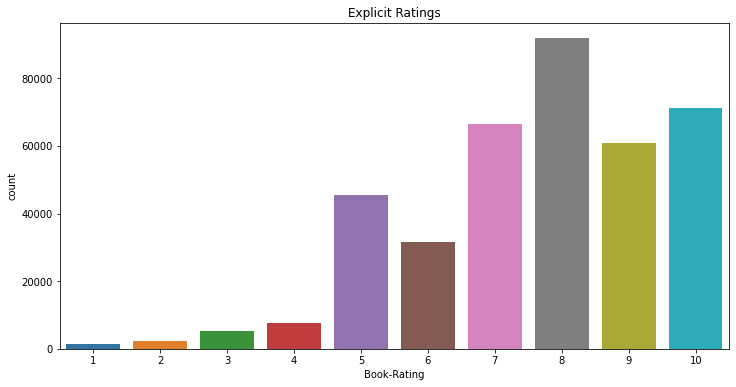

In [ ]:
## Explicit Ratings
plt.figure(figsize=(12,6))
data = explicit_dataset 
sns.countplot(x="Book-Rating", data=data)
plt.title("Explicit Ratings")

<h2><b>Recommendation Systems

In [ ]:
bookName = "Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))"
number = int(20)

# Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))

- <h3><b>Popularity Based

In [ ]:
def popularity_based(df, n):
    if n >= 1 and n <= len(df):
        data = pd.DataFrame(df.groupby('ISBN')['Book-Rating'].count()).sort_values('Book-Rating', ascending=False).head(n)
        output = pd.merge(data, books, on='ISBN')
        return output
    return "Invalid Number of Books!!"

In [ ]:
print("Top", number, "Popular books are: ")
popular_df=popularity_based(explicit_dataset, number)
popular_df

Top 20 Popular books are: 


,ISBN,Book-Rating,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
0,0316666343,707,The Lovely Bones: A Novel,Alice Sebold,2002,"Little, Brown",http://images.amazon.com/images/P/0316666343.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0316666343.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0316666343.01.LZZZZZZZ.jpg
1,0971880107,581,Wild Animus,Rich Shapero,2004,Too Far,http://images.amazon.com/images/P/0971880107.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0971880107.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0971880107.01.LZZZZZZZ.jpg
2,0385504209,488,The Da Vinci Code,Dan Brown,2003,Doubleday,http://images.amazon.com/images/P/0385504209.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0385504209.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0385504209.01.LZZZZZZZ.jpg
3,0312195516,383,The Red Tent (Bestselling Backlist),Anita Diamant,1998,Picador USA,http://images.amazon.com/images/P/0312195516.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0312195516.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0312195516.01.LZZZZZZZ.jpg
4,0060928336,320,Divine Secrets of the Ya-Ya Sisterhood: A Novel,Rebecca Wells,1997,Perennial,http://images.amazon.com/images/P/0060928336.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0060928336.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0060928336.01.LZZZZZZZ.jpg
5,059035342X,315,Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback)),J. K. Rowling,1999,Arthur A. Levine Books,http://images.amazon.com/images/P/059035342X.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/059035342X.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/059035342X.01.LZZZZZZZ.jpg
6,0142001740,314,The Secret Life of Bees,Sue Monk Kidd,2003,Penguin Books,http://images.amazon.com/images/P/0142001740.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0142001740.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0142001740.01.LZZZZZZZ.jpg
7,0446672211,295,Where the Heart Is (Oprah's Book Club (Paperback)),Billie Letts,1998,Warner Books,http://images.amazon.com/images/P/0446672211.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0446672211.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0446672211.01.LZZZZZZZ.jpg
8,044023722X,282,A Painted House,John Grisham,2001,Dell Publishing Company,http://images.amazon.com/images/P/044023722X.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/044023722X.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/044023722X.01.LZZZZZZZ.jpg
9,0452282152,278,Girl with a Pearl Earring,Tracy Chevalier,2001,Plume Books,http://images.amazon.com/images/P/0452282152.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0452282152.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0452282152.01.LZZZZZZZ.jpg


- <b><h3>Books by Same Author and  Publisher

In [ ]:
def printBook(data_frame, n):          #function will print the unique value of book title
    z = data_frame['Book-Title'].unique()
    y = data_frame['Image-URL-L'].unique()
    i = data_frame['Book-Author'].unique()
    
    for x in range(len(z)):
      w = data_frame['Book-Rating'][data_frame['Book-Title']==z[x]].count()
      print(z[x],y[x],i[0],w)
      if x >= n-1:
        break

In [ ]:
def get_books(dataframe, name, n):
    print("\nAuthors other Books:\n")
    unique_author = dataframe['Book-Author'].unique()      
    data = explicit_dataset [explicit_dataset ['Book-Title'] != name]

    if unique_author[0] in list(data['Book-Author'].unique()):  #checking for unique author name

        k2 = data[data['Book-Author'] == unique_author[0]]
    k2 = k2.sort_values(by=['Book-Rating'])
    printBook(k2, n)

    print("\n\nPublishers other Publication:\n")
    unique_author = dataframe['Publisher'].unique()

    if unique_author[0] in list(data['Publisher'].unique()):  #checking for unique author name
        k2 = pd.DataFrame(data[data['Publisher'] == unique_author[0]])
    k2=k2.sort_values(by=['Book-Rating']) 
    printBook(k2, n)

In [ ]:
if bookName in list(explicit_dataset['Book-Title'].unique()):
    df = explicit_dataset[explicit_dataset['Book-Title'] == bookName]
    get_books(df, bookName, number)
else:
    print("Invalid Book Name!!")


Authors other Books:

Harry Potter and the Goblet of Fire (Book 4) http://images.amazon.com/images/P/0439139597.01.LZZZZZZZ.jpg J. K. Rowling 247
Harry Potter and the Order of the Phoenix (Book 5) http://images.amazon.com/images/P/043935806X.01.LZZZZZZZ.jpg J. K. Rowling 211
Harry Potter y el cÃ¡liz de fuego http://images.amazon.com/images/P/8478886451.01.LZZZZZZZ.jpg J. K. Rowling 19
Harry Potter and the Chamber of Secrets (Book 2) http://images.amazon.com/images/P/0439064872.01.LZZZZZZZ.jpg J. K. Rowling 326
Harry Potter and the Sorcerer's Stone (Book 1) http://images.amazon.com/images/P/0590353403.01.LZZZZZZZ.jpg J. K. Rowling 176
Harry Potter and the Prisoner of Azkaban (Book 3) http://images.amazon.com/images/P/0439136350.01.LZZZZZZZ.jpg J. K. Rowling 277
Harry Potter y la piedra filosofal http://images.amazon.com/images/P/0439064864.01.LZZZZZZZ.jpg J. K. Rowling 13
Fantastic Beasts and Where to Find Them http://images.amazon.com/images/P/0439136369.01.LZZZZZZZ.jpg J. K. Rowling 

- <h3><b>Popular Books based on Year

In [ ]:
popular_year = pd.DataFrame(explicit_dataset.groupby('ISBN')['Book-Rating'].count()).sort_values('Book-Rating', ascending=False)
popular_year = pd.merge(popular_year, books, on='ISBN')

years = set()
indices = []
for ind, row in popular_year.iterrows():
    if row['Year-Of-Publication'] in years or row['Year-Of-Publication'] <= 1990:
        indices.append(ind)
    else:
        years.add(row['Year-Of-Publication'])

popular_year = popular_year.drop(indices)
popular_year = popular_year.drop('Book-Rating', axis = 1)
popular_year = popular_year.sort_values('Year-Of-Publication')

pd.set_option("display.max_rows", None, "display.max_columns", None)
popular_year

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L
13,0316769487,The Catcher in the Rye,J.D. Salinger,1991,"Little, Brown",http://images.amazon.com/images/P/0316769487.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0316769487.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0316769487.01.LZZZZZZZ.jpg
24,044021145X,The Firm,John Grisham,1992,Bantam Dell Publishing Group,http://images.amazon.com/images/P/044021145X.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/044021145X.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/044021145X.01.LZZZZZZZ.jpg
16,0345337662,Interview with the Vampire,Anne Rice,1993,Ballantine Books,http://images.amazon.com/images/P/0345337662.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0345337662.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0345337662.01.LZZZZZZZ.jpg
32,0804106304,The Joy Luck Club,Amy Tan,1994,Prentice Hall (K-12),http://images.amazon.com/images/P/0804106304.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0804106304.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0804106304.01.LZZZZZZZ.jpg
12,067976402X,Snow Falling on Cedars,David Guterson,1995,Vintage Books USA,http://images.amazon.com/images/P/067976402X.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/067976402X.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/067976402X.01.LZZZZZZZ.jpg
26,0671003755,She's Come Undone (Oprah's Book Club (Paperback)),Wally Lamb,1996,Washington Square Press,http://images.amazon.com/images/P/0671003755.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0671003755.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0671003755.01.LZZZZZZZ.jpg
4,0060928336,Divine Secrets of the Ya-Ya Sisterhood: A Novel,Rebecca Wells,1997,Perennial,http://images.amazon.com/images/P/0060928336.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0060928336.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0060928336.01.LZZZZZZZ.jpg
3,0312195516,The Red Tent (Bestselling Backlist),Anita Diamant,1998,Picador USA,http://images.amazon.com/images/P/0312195516.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0312195516.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0312195516.01.LZZZZZZZ.jpg
5,059035342X,Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback)),J. K. Rowling,1999,Arthur A. Levine Books,http://images.amazon.com/images/P/059035342X.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/059035342X.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/059035342X.01.LZZZZZZZ.jpg
17,0375727345,House of Sand and Fog,Andre Dubus III,2000,Vintage Books,http://images.amazon.com/images/P/0375727345.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0375727345.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0375727345.01.LZZZZZZZ.jpg


- <h3><b>Nearest Neighbours Based

In [ ]:
data = (explicit_dataset.groupby(by = ['Book-Title'])['Book-Rating'].count().reset_index().
        rename(columns = {'Book-Rating': 'Total-Rating'})[['Book-Title', 'Total-Rating']])
data

In [ ]:
result = pd.merge(data, explicit_dataset, on='Book-Title')
result = result[result['Total-Rating'] >= 50]
result = result.reset_index(drop = True)
result

In [ ]:
matrix = result.pivot_table(index = 'Book-Title', columns = 'User-ID', values = 'Book-Rating').fillna(0)
up_matrix = csr_matrix(matrix)

In [ ]:
explicit_dataset.head()

,ISBN,Book-Title,Book-Author,Year-Of-Publication,Publisher,Image-URL-S,Image-URL-M,Image-URL-L,User-ID,Book-Rating,Age,City,State,Country
0,0002005018,Clara Callan,Richard Bruce Wright,2001,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0002005018.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0002005018.01.LZZZZZZZ.jpg,8,5,35,timmins,ontario,canada
1,074322678X,Where You'll Find Me: And Other Stories,Ann Beattie,2002,Scribner,http://images.amazon.com/images/P/074322678X.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/074322678X.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/074322678X.01.LZZZZZZZ.jpg,8,5,35,timmins,ontario,canada
2,0887841740,The Middle Stories,Sheila Heti,2004,House of Anansi Press,http://images.amazon.com/images/P/0887841740.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/0887841740.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/0887841740.01.LZZZZZZZ.jpg,8,5,35,timmins,ontario,canada
3,1552041778,Jane Doe,R. J. Kaiser,1999,Mira Books,http://images.amazon.com/images/P/1552041778.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/1552041778.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/1552041778.01.LZZZZZZZ.jpg,8,5,35,timmins,ontario,canada
4,1567407781,The Witchfinder (Amos Walker Mystery Series),Loren D. Estleman,1998,Brilliance Audio - Trade,http://images.amazon.com/images/P/1567407781.01.THUMBZZZ.jpg,http://images.amazon.com/images/P/1567407781.01.MZZZZZZZ.jpg,http://images.amazon.com/images/P/1567407781.01.LZZZZZZZ.jpg,8,6,35,timmins,ontario,canada


In [ ]:
def func( name):
  unique_row = explicit_dataset[explicit_dataset['Book-Title'] == name].iloc[0]
  author = unique_row['Book-Author']
  url = unique_row['Image-URL-L']
  print(name, author ,url  )

In [ ]:
model = NearestNeighbors(metric = 'cosine', algorithm = 'brute')
model.fit(up_matrix)


NearestNeighbors(algorithm='brute', metric='cosine')

In [ ]:
distances, indices = model.kneighbors(matrix.loc["Where the Heart Is (Oprah's Book Club (Paperback))"].values.reshape(1, -1), n_neighbors = number+1)
for i in range(0, len(distances.flatten())):
  if i > 0:
        print(func(matrix.index[indices.flatten()[i]]) )

The Lovely Bones: A Novel Alice Sebold http://images.amazon.com/images/P/0316666343.01.LZZZZZZZ.jpg
None
Blue Diary Alice Hoffman http://images.amazon.com/images/P/0425184943.01.LZZZZZZZ.jpg
None
I Know This Much Is True Wally Lamb http://images.amazon.com/images/P/0060987561.01.LZZZZZZZ.jpg
None
The Pilot's Wife : A Novel Anita Shreve http://images.amazon.com/images/P/0316601950.01.LZZZZZZZ.jpg
None
Jewel Bret Lott http://images.amazon.com/images/P/0671038184.01.LZZZZZZZ.jpg
None
Icy Sparks Gwyn Hyman Rubio http://images.amazon.com/images/P/0142000205.01.LZZZZZZZ.jpg
None
The Book of Ruth (Oprah's Book Club (Paperback)) Jane Hamilton http://images.amazon.com/images/P/0385265700.01.LZZZZZZZ.jpg
None
Tis: A Memoir Frank McCourt http://images.amazon.com/images/P/0743200985.01.LZZZZZZZ.jpg
None
Bridget Jones's Diary Helen Fielding http://images.amazon.com/images/P/014028009X.01.LZZZZZZZ.jpg
None
Divine Secrets of the Ya-Ya Sisterhood: A Novel Rebecca Wells http://images.amazon.com/images/

In [ ]:
def funcpred(name):
  def funcnew( name):
    unique_row = explicit_dataset[explicit_dataset['Book-Title'] == name].iloc[0]
    author = unique_row['Book-Author']
    url = unique_row['Image-URL-L']
    return [name, author ,url  ]
  distances, indices = model.kneighbors(matrix.loc[name].values.reshape(1, -1), n_neighbors = number+1)
  ans = []
  for i in range(0, len(distances.flatten())):
    if i > 0:
        ans.append(funcnew(matrix.index[indices.flatten()[i]]) )
  return ans

In [ ]:
import pickle
pickle.dump(popular_df,open('popular.pkl','wb'))

In [ ]:
pickle.dump(popular_year,open('popular_year.pkl','wb'))

In [ ]:
import pickle

# Save the model to a file
with open('/content/drive/MyDrive/INTERNSHIP/matrix.pkl', 'wb') as f:
    pickle.dump(matrix, f)
# Save the model to a file
with open('/content/drive/MyDrive/INTERNSHIP/model.pkl', 'wb') as f:
    pickle.dump(model, f)
with open('/content/drive/MyDrive/INTERNSHIP/explicit_dataset.pkl', 'wb') as f:
    pickle.dump(explicit_dataset, f)
with open('/content/drive/MyDrive/INTERNSHIP/popular_year.pkl', 'wb') as f:
    pickle.dump(popular_year, f)

with open('/content/drive/MyDrive/INTERNSHIP/popular_df.pkl', 'wb') as f:
    pickle.dump(popular_df, f)
